# Rozdzielczość obrazu. Interpolacja.

## Cel zajęć:

* zapoznanie z pojęciem rozdzielczości przestrzennej (rozmiaru obrazu),
* metody interpolacji: najbliższego sąsiada oraz dwuliniowa,
* zapoznanie z pojęciem rozdzielczości **dpi** (ang. dots per inch),
* zapoznanie z pojęciem rozdzielczości  poziomów jasności (dla obrazów w skali szarości),
* zadanie domowe: interpolacja dwusześcienna.

## Rodzielczość przestrzenna

Dyskretna reprezentacja obrazu to zwykle macierz dwu- (N x M - obraz w skali szarości) lub trójwymiarowa (N x M x 3 - obraz kolorowy).
Przez rozdzielczość przestrzenną rozumie się liczbę pikseli, z których składa się obraz.
Przykładowo, rozdzielczość VGA to  640 x 480, FullHD to 1920 x 1080, a UltraHD (4K) to 3840 x 2160.
Rozdzielczość obrazu można modyfikować (zwiększać/zmniejszać), co nazywa się *skalowaniem* obrazu.
Warto wiedzieć, że zwiększenie rozdzielczości obrazu nie zwiększa ilości informacji, a jedynie liczbę pikseli (w sensie: "lepiej nie będzie").
Ponadto, skalowanie zawsze wprowadza pewne zniekształcenia, nawet przy zmniejszaniu rozmiaru.

W ramach niniejszego ćwiczenia zapoznamy się z metodami interpolacji, które są podstawą takich operacji jak: przybliżanie (zoom), zmiana rozdzielczości, rotacja obrazu czy też korekcje geometryczne.
Jako przykład posłuży nam zmiana rozdzielczości, czyli inaczej mówiąc **przepróbkowanie obrazu**.
Dla przypomnienia - interpolacja to wykorzystanie znanych danych (wartości dla tzw. punktów węzłowych) do określania wartości w nieznanych lokalizacjach.

Zacznijmy od prostego przykładu.
Mamy obraz o rozdzielczości 500 x 500 pikseli, a chcemy go powiększyć do 750 x 750 pikseli $-$ tj. o współczynnik 1,5.
Wyobraźmy sobie zatem, że dysponujemy siatką 750 x 750 o takim samym "rozmiarze" pojedynczego piksela jak obraz oryginalny.
Następnie, siatkę tę "ścieśniamy", tak aby miała rozmiar 500 x 500.
W rezultacie otrzymana siatka będzie miała mniejszy rozmiar pojedynczego piksela niż obraz oryginalny.
Schematycznie przedstawiono to na poniższym rysunku.

![Ilustracja interpolacji](https://raw.githubusercontent.com/vision-agh/poc_sw/master/05_Resolution/img/interEx57.png)


Pokazuje on przykład interpolacji: a) obraz 5x5, b) oraz 7x7, c) obraz 7x7 zmiejszony do 5x5.


Chcemy teraz poszczególnym elementom nowej siatki przyporządkować piksele z obrazu wejściowego.
Jedną z możliwości jest poszukanie "najbliższego" piksela w oryginalnym obrazie i wzięcie jego wartości.
Przykład takiego postępowania zaprezentowano na  poniższym rysunku.

![Ilustracja najbliższego sąsiada](https://raw.githubusercontent.com/vision-agh/poc_sw/master/05_Resolution/img/inteNNEx.png)

Kilka słów wyjaśnienia: kolorem ciemnoszarym oznaczono siatkę 5x5, a czarnym 7x7 (już po przeskalowaniu).
Nasze zadanie sprowadza się do znalezienia dla każdej kropki czarnej (umowny środek piksela), najbliżej leżącej kropki szarej - oznaczono to dla pierwszych trzech wierszy obrazu liniami.

Po zrealizowaniu powyższego kroku dla całego obrazu wykonujemy "rozciągnięcie" do rozdzielczości 750 x 750.
W ten sposób uzyskujemy finalny efekt zmiany rozdzielczości.

## Interpolacja metodą najbliższego sąsiada

Takie postępowanie określa się mianem **interpolacji metodą najbliższego sąsiada** (ang. *nearest neighbour interpolation*).
W ramach pierwszego etapu ćwiczenia zaimplementujemy to podejście.

1. Ładujemy potrzebne biblioteki, pobieramy obrazy z repozytorium, wczytujemy jeden z obrazów testowych (*parrot.bmp*) i wyświetlamy go:

In [1]:
import cv2
import os
import requests
from matplotlib import pyplot as plt
import numpy as np

url = 'https://raw.githubusercontent.com/vision-agh/poc_sw/master/05_Resolution/'
fileNames = ["parrot.bmp", "clock.bmp", "chessboard.bmp", "firetruck.jpg", "lena.bmp"]

for fileName in fileNames:
    if not os.path.exists(fileName):
        r = requests.get(url + fileName, allow_redirects = True)
        open(fileName, 'wb').write(r.content)

parrot = cv2.imread('parrot.bmp')                 # Read image
parrot = cv2.cvtColor(parrot, cv2.COLOR_BGR2GRAY) # Convert from BGR

In [2]:
# Pomocnicza funkcja wyświetlająca pojedynczy obrazek
def display_image(image, title):
    print(f"\n{title}, rozmiar obrazka: {image.shape[0]}x{image.shape[1]}")
    
    plt.figure(figsize = (image.shape[1] / 60, image.shape[0] / 60), dpi = 200)
    plt.imshow(image, cmap = "gray")
    plt.xticks([]), plt.yticks([])                    # Hides the graph ticks and x / y axis
    plt.show()


Obraz parrot.bmp, rozmiar obrazka: 100x100


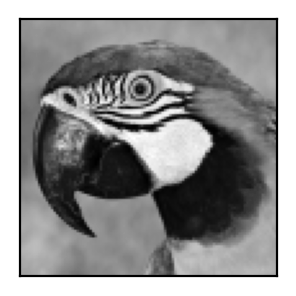

In [3]:
# Display
display_image(parrot, "Obraz parrot.bmp")

2. Definiujemy funkcję do interpolacji metodą najbliższego sąsiada.

Jako argumenty wejściowe powinna ona przyjąć obraz oraz współczynniki skalowania w pionie i poziomie.
Wyjściem powinien być natomiast obraz w nowej rozdzielczości.
Wewnątrz należy:

* odczytać wymiary obrazka wejściowego,
* wyliczyć wymiary obrazka wyjściowego (tj. wymnożyć wymiary wejściowe przez skalę i zaokrąglić do liczb całkowitych),
* utworzyć nowy obraz o ww. rozmiarze,
* w pętli po nowym obrazie, dla każdego piksela, wykorzystując współczynniki skalowania, odnaleźć najbliższego sąsiada.




In [4]:
# TODO: Do samodzielnej implemetantacji
def nearest_neighbour_interpolation(image, vscale, hscale):
    (X, Y) = image.shape
    newX = round(X * vscale)
    newY = round(Y * hscale)
    
    new_image = np.zeros((newX, newY))
    
    for x in range(newX):
        x_orig = round(x / vscale)
        x_orig = min(x_orig, X - 1)
        
        for y in range(newY):
            y_orig = round(y / hscale)
            y_orig = min(y_orig, Y - 1)
            
            new_image[x, y] = image[x_orig, y_orig]
            
    return new_image

3. Testujemy stworzoną funkcję:
    * dla skali 1.5, 1.5 i obrazka *parrot*,
    * dla 2.5, 2.5 - tu może okazać się, że do kodu trzeba dopisać zabezpieczenie przed wyjściem poza zakres,
    * dla niejednakowych skal, np. 1.5 i 2.5,
    * dla skal mniejszych od 1,
    * dla niesymetrycznego obrazka *clock.bmp*,
    * dla obrazka z szachownicą *chessboard.bmp*.

Uwaga: proszę dla powyższych przypadków przygotować osobne sekcje kodu - tak, aby wyświetlały się wszystkie rozważane przypadki.

Wykonana metoda jest bardzo prosta i szybka, ale wprowadza pewne niepożądane artefakty, w szczególności źle odwzorowane są linie proste.
Z drugiej strony, sprawdza się w pewnych nietypowych przypadkach.
Zostanie to zademonstrowane w dalszej części ćwiczenia.

In [5]:
# Pomocnicza funkcja wyświetlająca pojedynczy interpolowany obrazek
def display_int_image(image, title):
    print(f"\n{title} -> rozmiar obrazka: {image.shape[0]}x{image.shape[1]}")
    
    plt.figure(figsize = (image.shape[1] / 60, image.shape[0] / 60), dpi = 200)
    plt.imshow(image, cmap = "gray")
    plt.xticks([]), plt.yticks([])
    plt.show()


Obraz parrot.bmp, współczynniki: 1.5, 1.5 -> rozmiar obrazka: 150x150


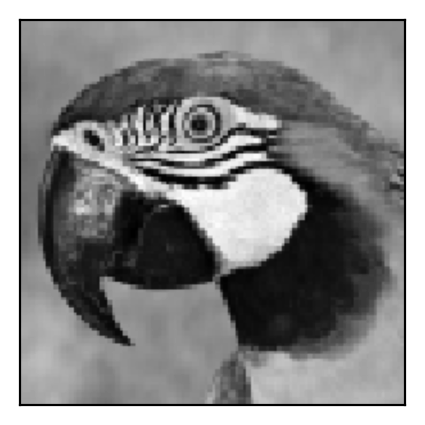


Obraz parrot.bmp, współczynniki: 2.5, 2.5 -> rozmiar obrazka: 250x250


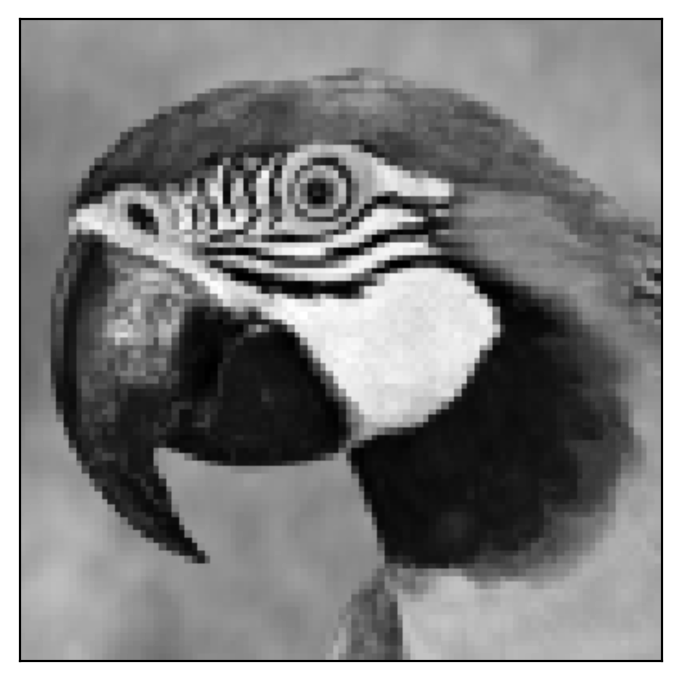


Obraz parrot.bmp, współczynniki: 1.5, 2.5 -> rozmiar obrazka: 150x250


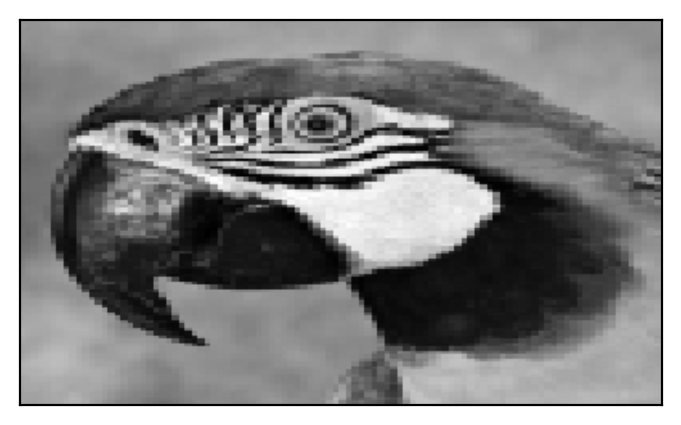


Obraz parrot.bmp, współczynniki: 0.6, 0.8 -> rozmiar obrazka: 60x80


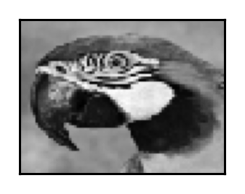

In [6]:
# TODO: Do samodzielnej implemetantacji
display_int_image(nearest_neighbour_interpolation(parrot, 1.5, 1.5), "Obraz parrot.bmp, współczynniki: 1.5, 1.5")
display_int_image(nearest_neighbour_interpolation(parrot, 2.5, 2.5), "Obraz parrot.bmp, współczynniki: 2.5, 2.5")
display_int_image(nearest_neighbour_interpolation(parrot, 1.5, 2.5), "Obraz parrot.bmp, współczynniki: 1.5, 2.5")
display_int_image(nearest_neighbour_interpolation(parrot, 0.6, 0.8), "Obraz parrot.bmp, współczynniki: 0.6, 0.8")


Obraz clock.bmp, rozmiar obrazka: 100x82


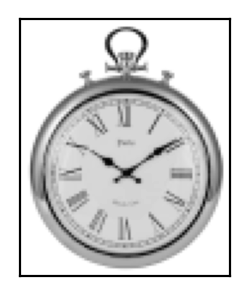

In [7]:
clock = cv2.imread('clock.bmp')
clock = cv2.cvtColor(clock, cv2.COLOR_BGR2GRAY)

display_image(clock, "Obraz clock.bmp")


Obraz clock.bmp, współczynniki: 1.5, 1.5 -> rozmiar obrazka: 150x123


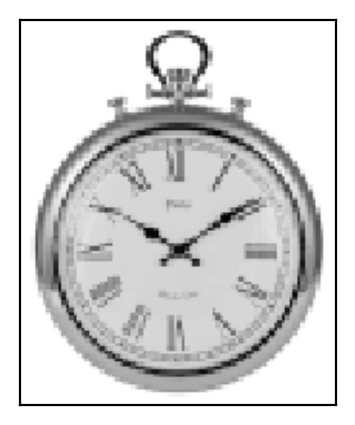


Obraz clock.bmp, współczynniki: 2.5, 2.5 -> rozmiar obrazka: 250x205


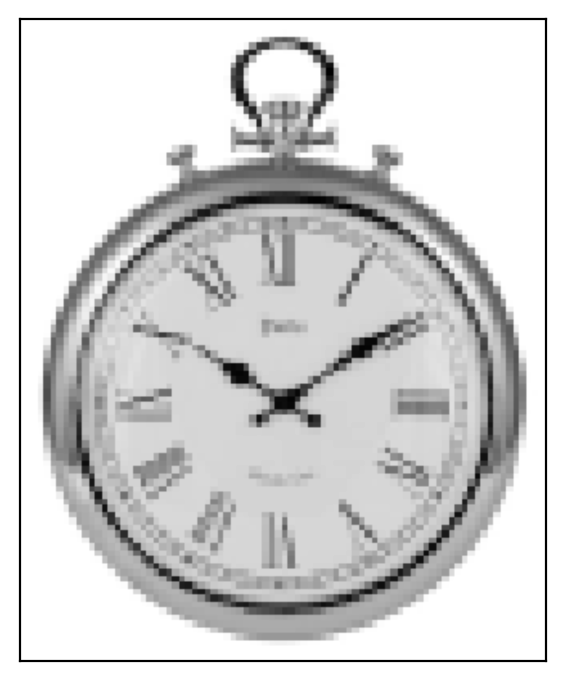


Obraz clock.bmp, współczynniki: 1.5, 2.5 -> rozmiar obrazka: 150x205


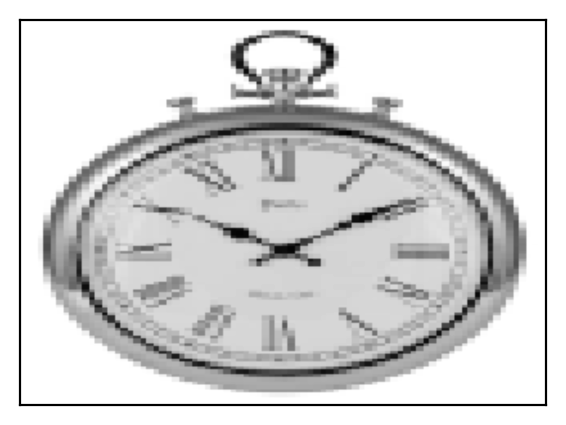


Obraz clock.bmp, współczynniki: 0.6, 0.8 -> rozmiar obrazka: 60x66


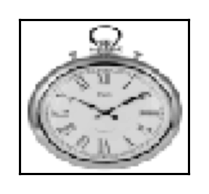

In [8]:
display_int_image(nearest_neighbour_interpolation(clock, 1.5, 1.5), "Obraz clock.bmp, współczynniki: 1.5, 1.5")
display_int_image(nearest_neighbour_interpolation(clock, 2.5, 2.5), "Obraz clock.bmp, współczynniki: 2.5, 2.5")
display_int_image(nearest_neighbour_interpolation(clock, 1.5, 2.5), "Obraz clock.bmp, współczynniki: 1.5, 2.5")
display_int_image(nearest_neighbour_interpolation(clock, 0.6, 0.8), "Obraz clock.bmp, współczynniki: 0.6, 0.8")


Obraz chessboard.bmp, rozmiar obrazka: 16x16


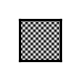

In [9]:
chessboard = cv2.imread('chessboard.bmp')
chessboard = cv2.cvtColor(chessboard, cv2.COLOR_BGR2GRAY)

display_image(chessboard, "Obraz chessboard.bmp")


Obraz chessboard.bmp, współczynniki: 1.5, 1.5 -> rozmiar obrazka: 24x24


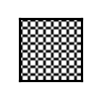


Obraz chessboard.bmp, współczynniki: 2.5, 2.5 -> rozmiar obrazka: 40x40


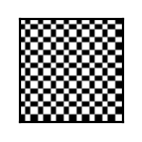


Obraz chessboard.bmp, współczynniki: 1.5, 2.5 -> rozmiar obrazka: 24x40


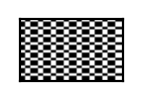


Obraz chessboard.bmp, współczynniki: 0.6, 0.8 -> rozmiar obrazka: 10x13


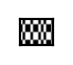

In [10]:
display_int_image(nearest_neighbour_interpolation(chessboard, 1.5, 1.5), "Obraz chessboard.bmp, współczynniki: 1.5, 1.5")
display_int_image(nearest_neighbour_interpolation(chessboard, 2.5, 2.5), "Obraz chessboard.bmp, współczynniki: 2.5, 2.5")
display_int_image(nearest_neighbour_interpolation(chessboard, 1.5, 2.5), "Obraz chessboard.bmp, współczynniki: 1.5, 2.5")
display_int_image(nearest_neighbour_interpolation(chessboard, 0.6, 0.8), "Obraz chessboard.bmp, współczynniki: 0.6, 0.8")

## Interpolacja dwuliniowa

W praktyce, lepszym rozwiązaniem zwykle okazuje się tzw. **interpolacja dwuliniowa** (ang. *bilinear interpolation*).
Wykorzystuje ona informację o czterech najbliższych sąsiadach do określenia nowej wartości piksela.

Jeśli przez $(i,j)$ oznaczymy współrzędne poszukiwanego piksela, a przez $I(i,j)$ jego jasność (składową w odcieniach szarości), to jego wartość można obliczyć, wykorzystując równanie:
\begin{equation}
I(i,j) = a \cdot i + b \cdot j+ c \cdot i \cdot j + d
\end{equation}
gdzie współczynniki $a,b,c,d$ można wyliczyć na podstawie czterech najbliższych sąsiadów:

![Ilustracja dwuliniowej](https://raw.githubusercontent.com/vision-agh/poc_sw/master/05_Resolution/img/interABCD.png)

Prześledźmy to na przykładzie z powyższego rysunku.
Niech współrzędne poszczególnych punktów to $A = (j_1,i_1)$, $B = (j_1,i_2)$, $ C= (j_2,i_2)$ oraz $D = (j_2,i_1)$.
W pierwszej kolejności dokonujemy interpolacji wartości w punktach $AB$ i $CD$ $-$ czyli poziomo.
Wychodząc od równania prostej otrzymujemy:

\begin{equation}
f(AB) \approx \frac{i_2 - i}{i_2-i_1}f(A) + \frac{i - i_1}{i_2-i_1}f(B)
\end{equation}

\begin{equation}
f(CD) \approx \frac{i_2 - i}{i_2-i_1}f(D) + \frac{i - i_1}{i_2-i_1}f(C)
\end{equation}

Następnie wykonujemy analogiczną interpolację w pionie:
\begin{equation}
f(ABCD) \approx \frac{j_2 - j}{j_2-j_1}f(AB) + \frac{j - j_1}{j_2-j_1}f(CD)
\end{equation}

Łącząc powyższe równania otrzymujemy:
\begin{equation}
f(ABCD) \approx \frac{1}{(i_2 - i_1)(j_2-j_1)} ( f(A)(i_2-i)(j_2 - j) + f(B)(i-i_1)(j_2 - j) \\ + f(C)(i-i_1)(j-j_1) + f(D)(i_2-i)(j-j_1))
\end{equation}
gdzie zapis $f(X)$ oznacza wartość piksela w punkcie $X$.

Rozważania można uprościć, przyjmując, że narożniki rozpatrywanego kwadratu mają następujące współrzędne: $A = (0,0)$, $B = (0,1)$, $ C= (1,1)$ oraz $D = (1,0)$.
Wtedy powyższe równanie można zapisać:
\begin{equation}
f(ABCD) \approx f(A)(1-i)(1-j) + f(B)i(1-j) + f(C)ij + f(D)(1-i)j
\end{equation}

lub macierzowo:
\begin{equation}
f(ABCD) \approx \begin{bmatrix}1 - i & i \end{bmatrix} \begin{bmatrix} f(A) & f(B) \\\\ f(D) & f(C)  \end{bmatrix}   \begin{bmatrix} 1-j \\\\ j  \end{bmatrix}
\end{equation}

Uwaga: nieco wbrew nazwie, interpolacja dwuliniowa **nie jest** operacją liniową.
W złożeniu dwóch operacji liniowych pojawia się człon $xy$.

Warto dodać, że kolejny "poziom wtajemniczenia" to **interpolacja dwusześcienna** (ang. *bicubic interpolation*).
Dana jest ona wzorem:
\begin{equation}
I(i,j) = \sum_{i=0}^{3} \sum_{j=0}^{3} a_{ij} x^i y^j
\end{equation}
Jej implementacja stanowi zadanie domowe do bieżącego ćwiczenia.

Trzy powyżej przedstawione metody bynajmniej nie wyczerpują tematu.
Wystarczy choćby otworzyć [stronę Wikipedii o skalowaniu](https://en.wikipedia.org/wiki/Image_scaling), by zobaczyć, że metod jest dużo więcej.



Wykorzystując powyższe równania zaimplementuj interpolację dwuliniową:
* dobrym punktem wyjścia będzie stworzona funkcja do interpolacji metodą najbliższego sąsiada,
* początek powinien być identyczny,
* różnice rozpoczynają się w momencie obliczenia współrzędnych nowego piksela,
* jeśli chcemy zastosować opisane powyżej wzory (w wariancie uproszczonym), to musimy wyliczyć współrzędne punktów $A,B,C,D$,
* w pierwszym kroku obliczamy współrzędne $A$ tj. $(0,0)$ - należy do tego wykorzystać funkcję *floor* (np. $i_1 = floor(i / h_{scale})$).
  Proszę ten krok odnieść do przedstawionego rysunku poglądowego,
* obliczenie współrzędnych $B,C,D$ jest już proste i sprowadza się do operacji `+1`,
* potrzebujemy jeszcze część ułamkową współrzędnych punktu $ABCD$ tj. $(i,j)$ - od ilorazu $i/h_{scale}$ należy odjąć wartość $i_1$
* wykorzystując wyznaczone współrzędne, należy pobrać wartości jasności w punktach $A,B,C,D$, tj. $f(A),f(B),f(C),f(D)$, podstawić do odpowiedniego równania i wykonać interpolację.

  Uwagi:
* Tworzenie macierzy: *np.array*, mnożenie macierzy: *np.dot*. Przy tworzeniu macierzy proszę zwrócić uwagę na *niezbędne* nawiasy kwadratowe.
* Przy próbie uruchomienia kodu pewnie okaże się, że wystąpi przekroczenie zakresu - należy dodać stosowne zabezpieczenie.

Proszę dla interpolacji dwuliniowej wykonać takie same eksperymenty, jak dla  najbliższego sąsiada.




In [11]:
# TODO: Do samodzielnej implementacji
def bilinear_interpolation(image, vscale, hscale):
    (X, Y) = image.shape
    newX = round(X * vscale)
    newY = round(Y * hscale)
    
    new_image = np.zeros((newX, newY))
    
    for x in range(newX):
        x_A = int(x / vscale)
        x_A = min(x_A, X - 2)
        
        for y in range(newY):
            y_A = int(y / hscale)
            y_A = min(y_A, Y - 2)
            
            f_A = image[x_A, y_A]
            f_B = image[x_A, y_A + 1]
            f_C = image[x_A + 1, y_A + 1]
            f_D = image[x_A + 1, y_A]
            
            i = x / vscale - x_A
            j = y / hscale - y_A
            
            new_image[x, y] = np.array([1. - i, i]) @ np.array([[f_A, f_B], [f_D, f_C]]) @ np.array([1. - j, j]).T
            
    return new_image


Obraz parrot.bmp, współczynniki: 1.5, 1.5 -> rozmiar obrazka: 150x150


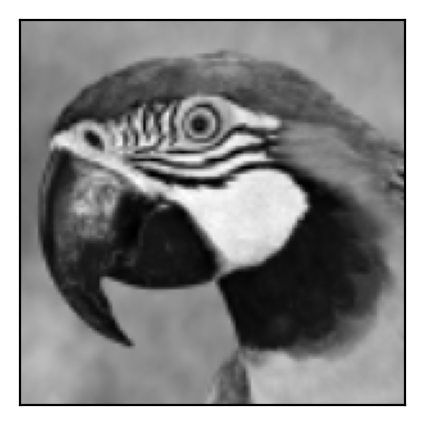


Obraz parrot.bmp, współczynniki: 2.5, 2.5 -> rozmiar obrazka: 250x250


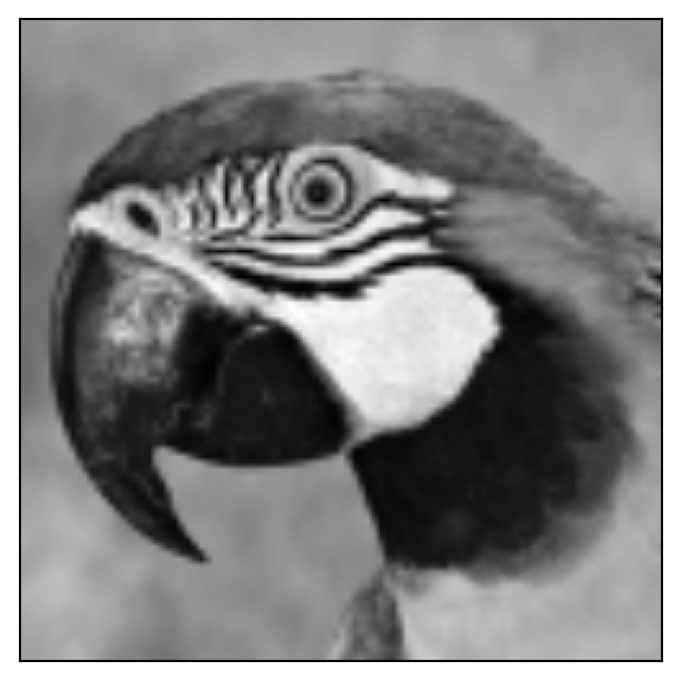


Obraz parrot.bmp, współczynniki: 1.5, 2.5 -> rozmiar obrazka: 150x250


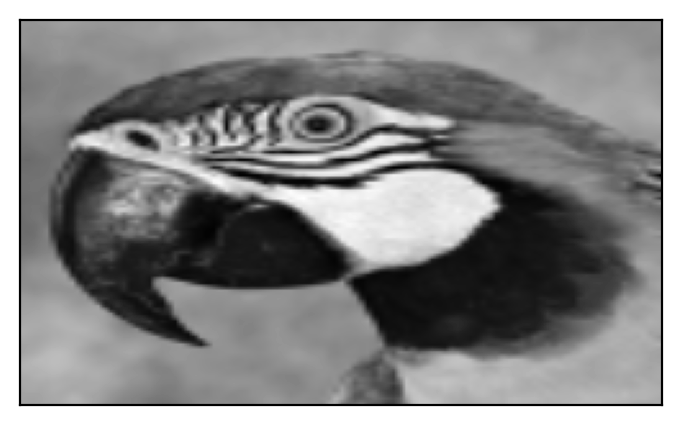


Obraz parrot.bmp, współczynniki: 0.6, 0.8 -> rozmiar obrazka: 60x80


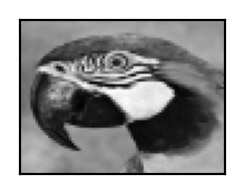

In [12]:
# TODO: Do samodzielnej implementacji
display_int_image(bilinear_interpolation(parrot, 1.5, 1.5), "Obraz parrot.bmp, współczynniki: 1.5, 1.5")
display_int_image(bilinear_interpolation(parrot, 2.5, 2.5), "Obraz parrot.bmp, współczynniki: 2.5, 2.5")
display_int_image(bilinear_interpolation(parrot, 1.5, 2.5), "Obraz parrot.bmp, współczynniki: 1.5, 2.5")
display_int_image(bilinear_interpolation(parrot, 0.6, 0.8), "Obraz parrot.bmp, współczynniki: 0.6, 0.8")


Obraz clock.bmp, współczynniki: 1.5, 1.5 -> rozmiar obrazka: 150x123


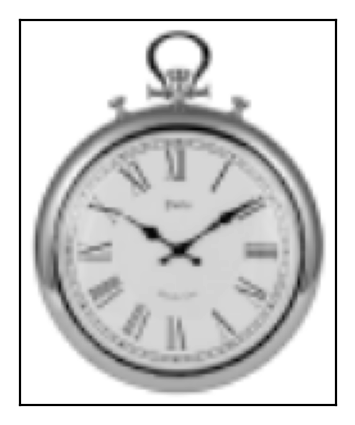


Obraz clock.bmp, współczynniki: 2.5, 2.5 -> rozmiar obrazka: 250x205


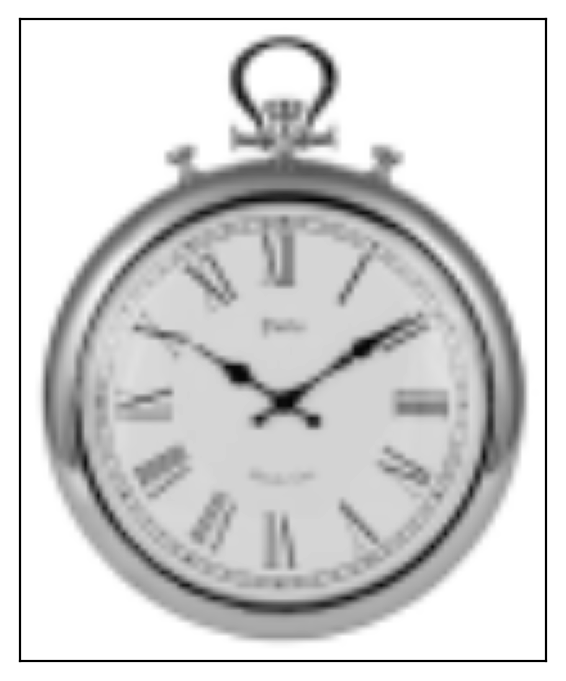


Obraz clock.bmp, współczynniki: 1.5, 2.5 -> rozmiar obrazka: 150x205


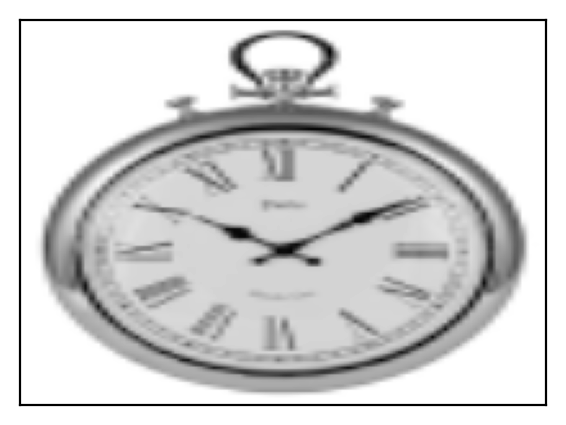


Obraz clock.bmp, współczynniki: 0.6, 0.8 -> rozmiar obrazka: 60x66


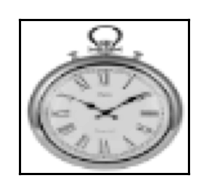

In [13]:
display_int_image(bilinear_interpolation(clock, 1.5, 1.5), "Obraz clock.bmp, współczynniki: 1.5, 1.5")
display_int_image(bilinear_interpolation(clock, 2.5, 2.5), "Obraz clock.bmp, współczynniki: 2.5, 2.5")
display_int_image(bilinear_interpolation(clock, 1.5, 2.5), "Obraz clock.bmp, współczynniki: 1.5, 2.5")
display_int_image(bilinear_interpolation(clock, 0.6, 0.8), "Obraz clock.bmp, współczynniki: 0.6, 0.8")


Obraz chessboard.bmp, współczynniki: 1.5, 1.5 -> rozmiar obrazka: 24x24


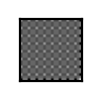


Obraz chessboard.bmp, współczynniki: 2.5, 2.5 -> rozmiar obrazka: 40x40


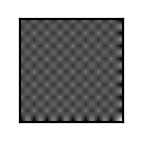


Obraz chessboard.bmp, współczynniki: 1.5, 2.5 -> rozmiar obrazka: 24x40


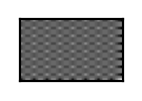


Obraz chessboard.bmp, współczynniki: 0.6, 0.8 -> rozmiar obrazka: 10x13


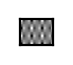

In [14]:
display_int_image(bilinear_interpolation(chessboard, 1.5, 1.5), "Obraz chessboard.bmp, współczynniki: 1.5, 1.5")
display_int_image(bilinear_interpolation(chessboard, 2.5, 2.5), "Obraz chessboard.bmp, współczynniki: 2.5, 2.5")
display_int_image(bilinear_interpolation(chessboard, 1.5, 2.5), "Obraz chessboard.bmp, współczynniki: 1.5, 2.5")
display_int_image(bilinear_interpolation(chessboard, 0.6, 0.8), "Obraz chessboard.bmp, współczynniki: 0.6, 0.8")

## Interpolacja w OpenCV

W OpenCV dostępna jest funkcja `resize`, która służy do zmiany rozmiaru obrazka.
Składnia jest następująca: `dst = cv2.resize(src, dsize[, dst[, fx[, fy[, interpolation]]]])`, gdzie `dst` to obraz wynikowy, `src` to obraz źródłowy, `dsize` to rozmiar docelowy (ew. można podać współczynniki skalowania dla poszczególnych osi: `fx, fy`), `interpolation` - metoda interpolacji.
Metod podstawowych dostępnych jest 5:
- najbliższego sąsiada - `cv2.INTER_NEAREST`,
- dwuliniowa - `cv2.INTER_LINEAR`,
- dwukubiczna - `cv2.INTER_CUBIC`,
- *area* - `cv2.INTER_AREA`,
- *lanczos4* - `cv2.INTER_LANCZOS4`.

Przeprowadzimy następujący eksperyment: obraz (o większej niż dotąd rozdzielczości) przeskalujemy każdą z metod $-$ zwiększymy i zmniejszymy jego rozdzielczość. Dodamy też pomiar czasu realizacji obliczeń.

Proszę stworzyć funkcję, która jako argumenty przyjmuje obraz oraz dwa współczynniki skalujące, a wewnątrz przeprowadzone zostaną interpolacje, pomiar czasu oraz wizualizacja (można wypisać czas w tytule rysunku).

Pomiar czasu:
```{python}
from timeit import default_timer as timer
start = timer()
# ...
end = timer()
print(end - start)
```

Wykonaj eksperyment dla kilku różnych skal, przeanalizuj czasy obliczeń.

In [15]:
from timeit import default_timer as timer

# TODO Do samodzielnej implementacji
def single_interpolation(image, vscale, hscale, interpolation_method):
    total_time = 0.
    iterations = 50
    result = None
    
    for i in range(iterations):
        start = timer()
        result = cv2.resize(image, (0, 0), fx = hscale, fy = vscale, interpolation = interpolation_method)
        end = timer()
        
        total_time += end - start
        
    return result, total_time / iterations
    
def compare_interpolation_methods(image, image_name, vscale, hscale):
    new_shape = (image.shape[0] * vscale, image.shape[1] * hscale)
    title_p1 = f"Porównanie metod interpolacji dla obrazu {image_name}, współczynniki: {vscale}, {hscale}"
    title_p2 = f" -> rozmiar obrazka: {new_shape[0]}x{new_shape[1]}"
    
    print(f"\n{title_p1}{title_p2}")
    
    result, avg_time = single_interpolation(image, vscale, hscale, cv2.INTER_NEAREST)
    plt.figure(figsize = (new_shape[1] / 300, new_shape[0] / 300), dpi = 200)
    plt.title(f"cv2.INTER_NEAREST - średni czas {avg_time:.4f}s", fontsize = 6)
    plt.imshow(result)
    plt.axis('off')
    plt.show()

    result, avg_time = single_interpolation(image, vscale, hscale, cv2.INTER_LINEAR)
    plt.figure(figsize = (new_shape[1] / 300, new_shape[0] / 300), dpi = 200)
    plt.title(f"cv2.INTER_LINEAR - średni czas {avg_time:.4f}s", fontsize = 6)
    plt.imshow(result)
    plt.axis('off')
    plt.show()

    result, avg_time = single_interpolation(image, vscale, hscale, cv2.INTER_CUBIC)
    plt.figure(figsize = (new_shape[1] / 300, new_shape[0] / 300), dpi = 200)
    plt.title(f"cv2.INTER_CUBIC - średni czas {avg_time:.4f}s", fontsize = 6)
    plt.imshow(result)
    plt.axis('off')
    plt.show()

    result, avg_time = single_interpolation(image, vscale, hscale, cv2.INTER_AREA)
    plt.figure(figsize = (new_shape[1] / 300, new_shape[0] / 300), dpi = 200)
    plt.title(f"cv2.INTER_AREA - średni czas {avg_time:.4f}s", fontsize = 6)
    plt.imshow(result)
    plt.axis('off')
    plt.show()

    result, avg_time = single_interpolation(image, vscale, hscale, cv2.INTER_LANCZOS4)
    plt.figure(figsize = (new_shape[1] / 300, new_shape[0] / 300), dpi = 200)
    plt.title(f"cv2.INTER_LANCZOS4 - średni czas {avg_time:.4f}s", fontsize = 6)
    plt.imshow(result)
    plt.axis('off')
    plt.show()


Obraz firetruck.jpg, rozmiar obrazka: 633x950


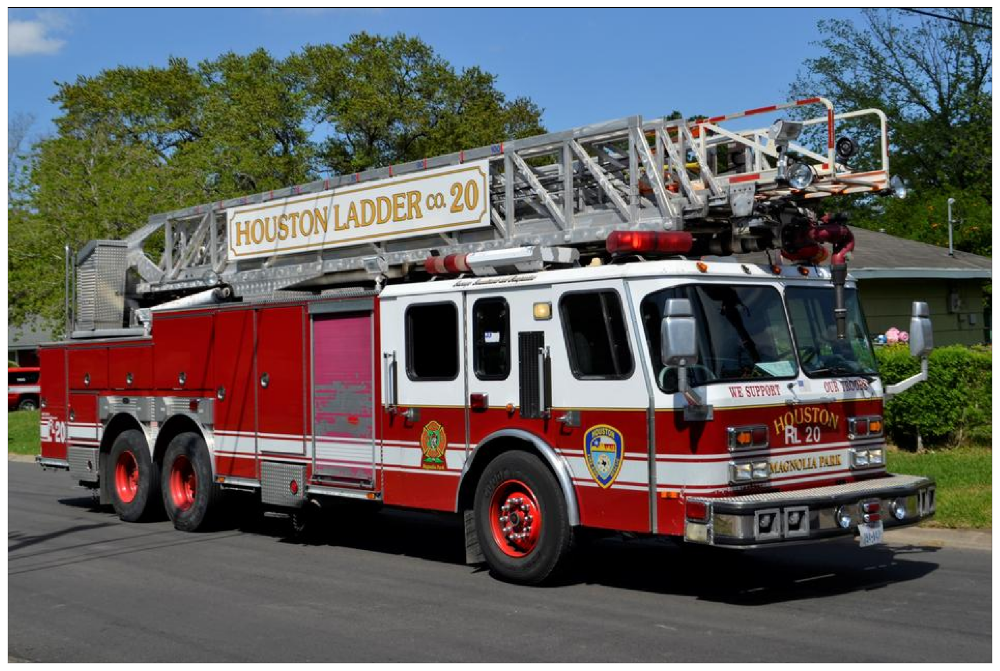

In [16]:
firetruck = cv2.imread('firetruck.jpg')
firetruck = cv2.cvtColor(firetruck, cv2.COLOR_BGR2RGB)

display_image(firetruck, "Obraz firetruck.jpg")


Porównanie metod interpolacji dla obrazu firetruck.jpg, współczynniki: 1.5, 1.5 -> rozmiar obrazka: 949.5x1425.0


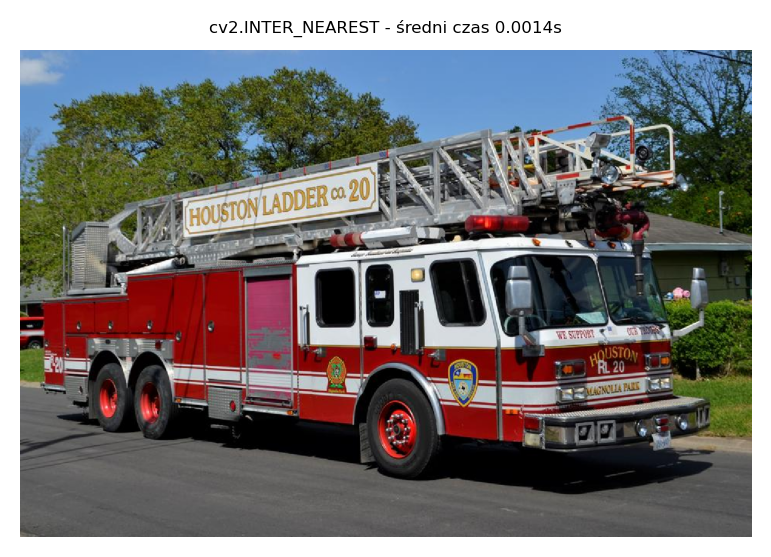

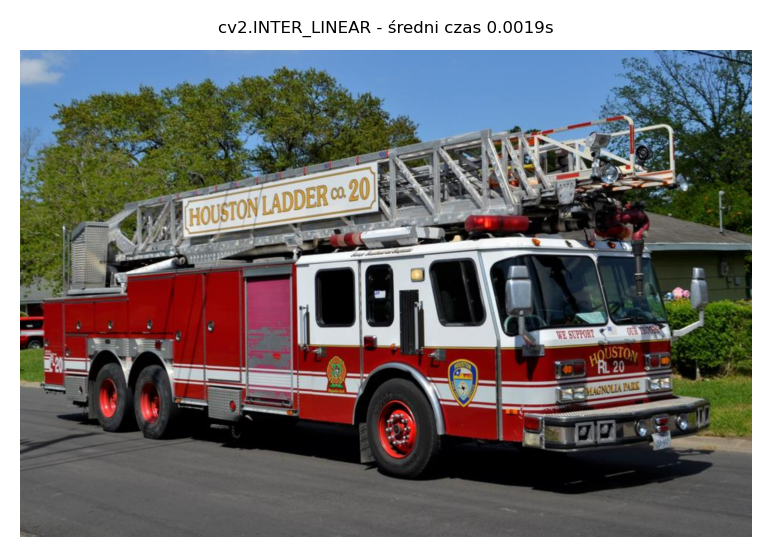

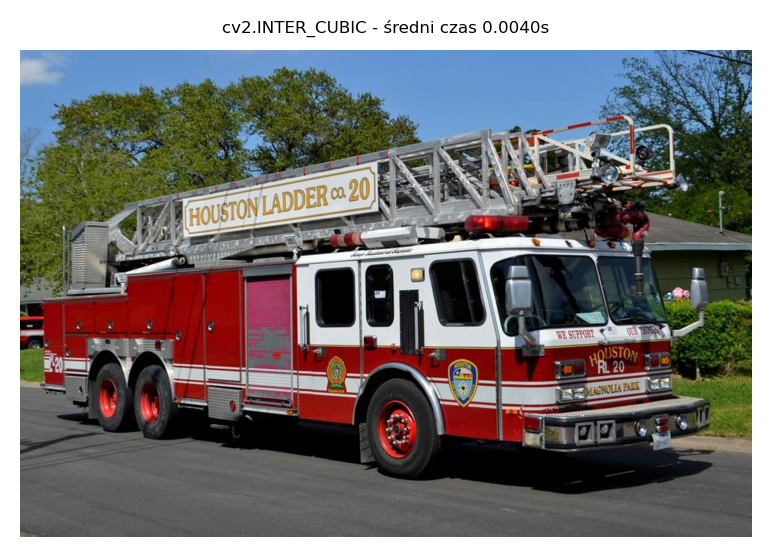

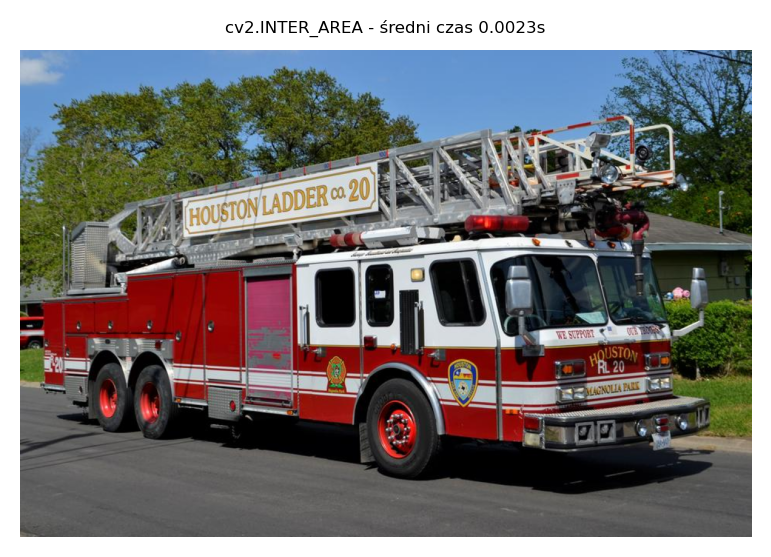

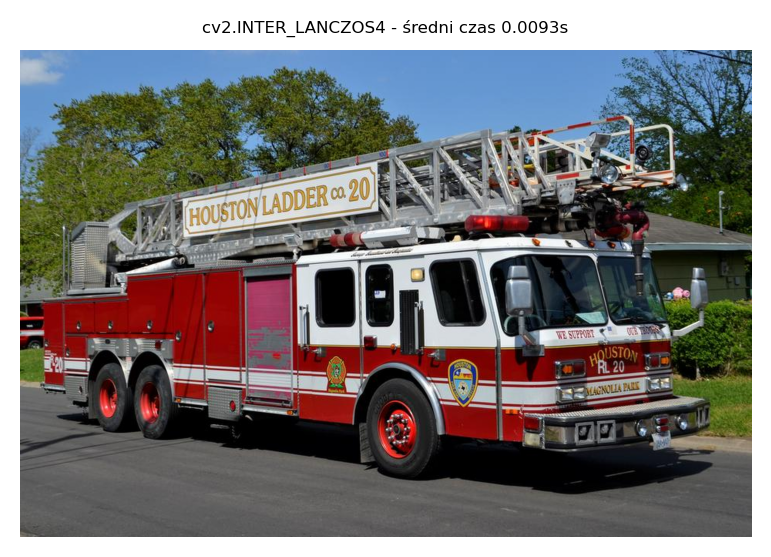


Porównanie metod interpolacji dla obrazu firetruck.jpg, współczynniki: 2.5, 2.5 -> rozmiar obrazka: 1582.5x2375.0


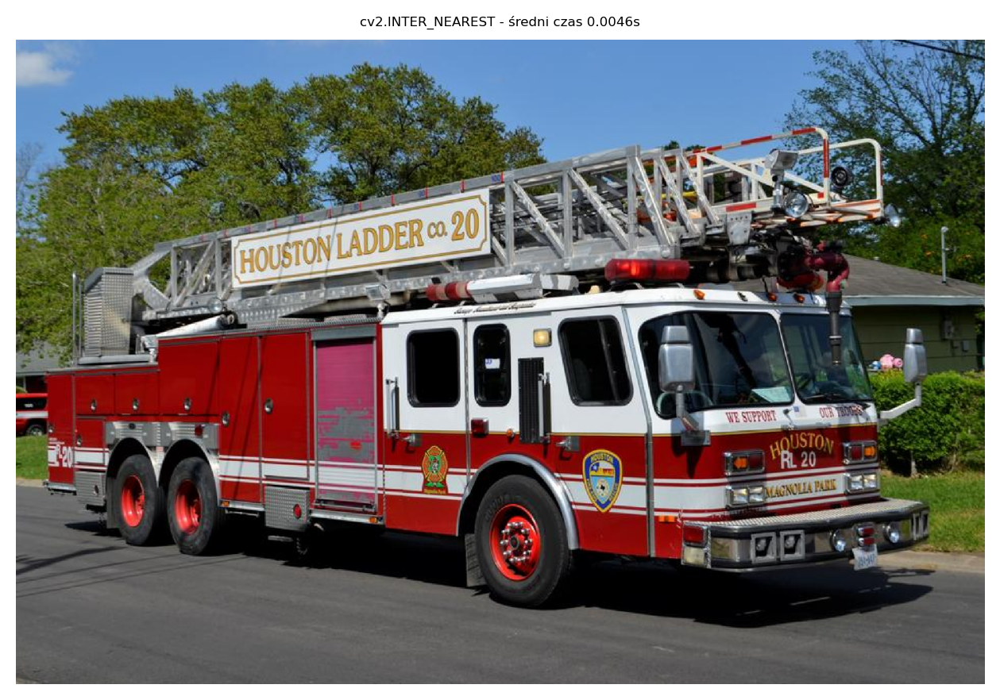

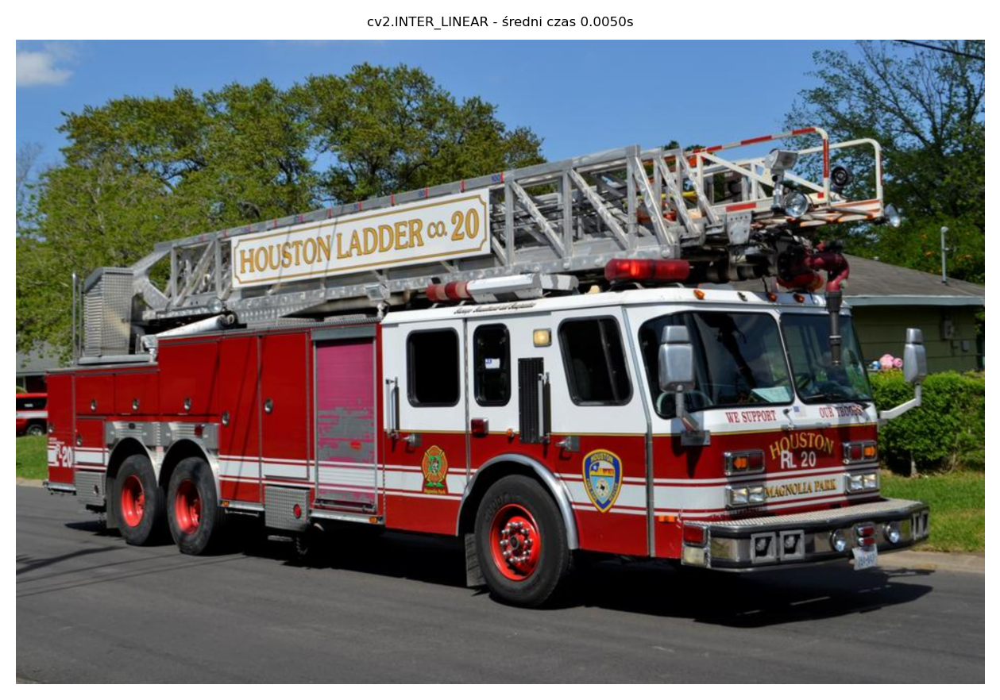

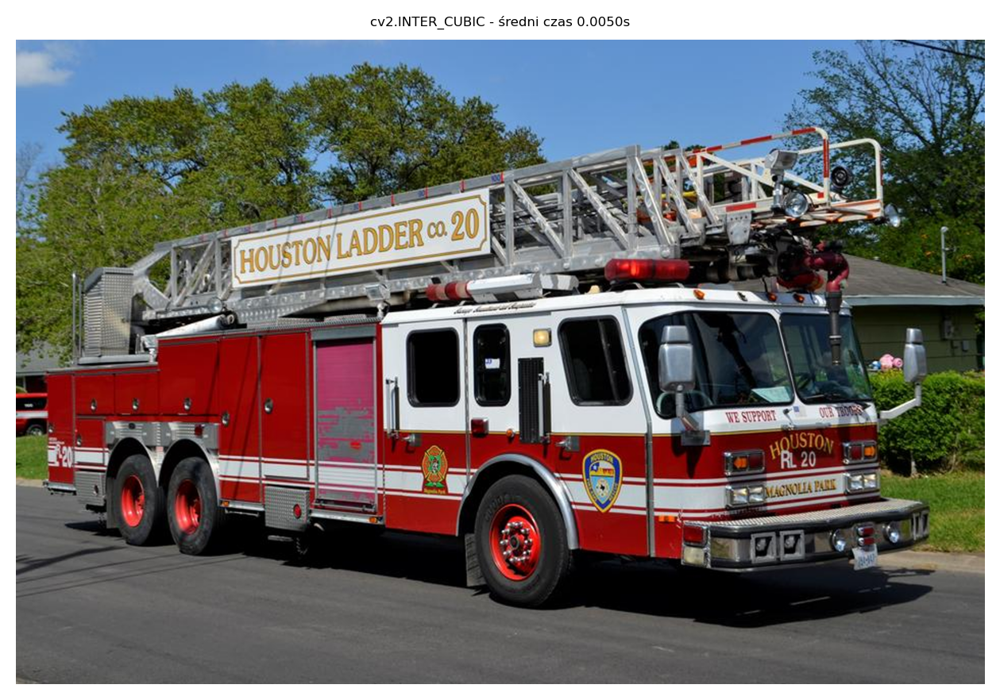

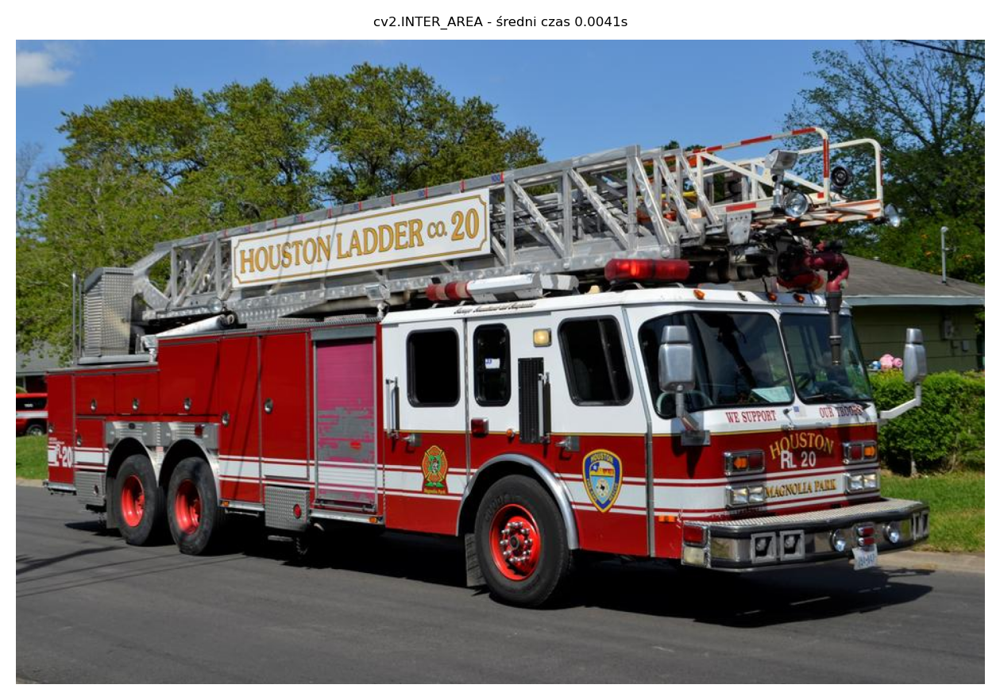

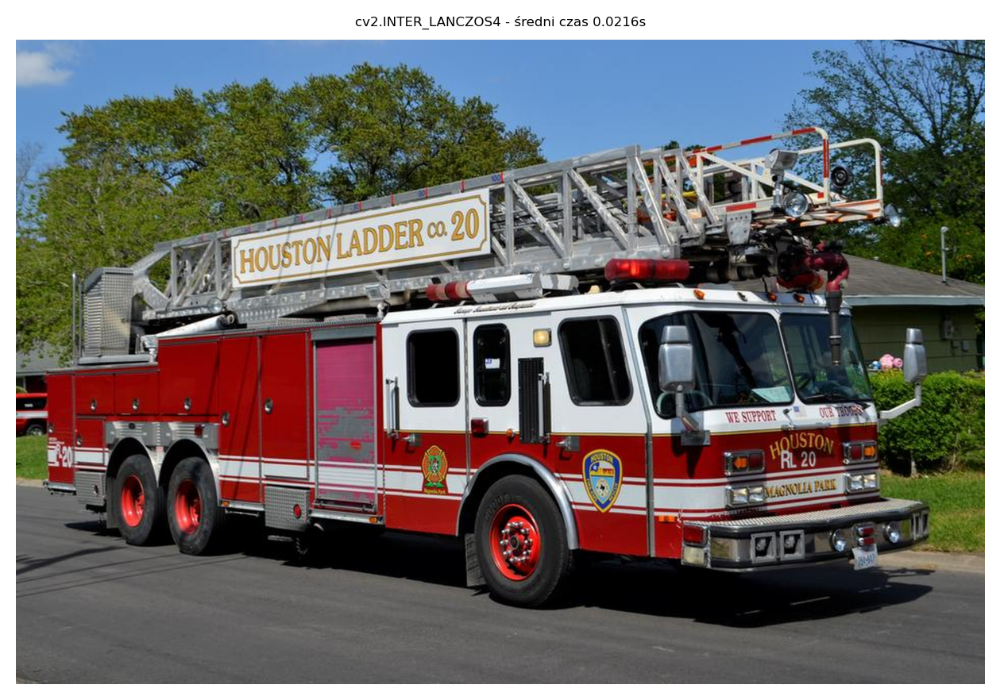


Porównanie metod interpolacji dla obrazu firetruck.jpg, współczynniki: 1.5, 2.5 -> rozmiar obrazka: 949.5x2375.0


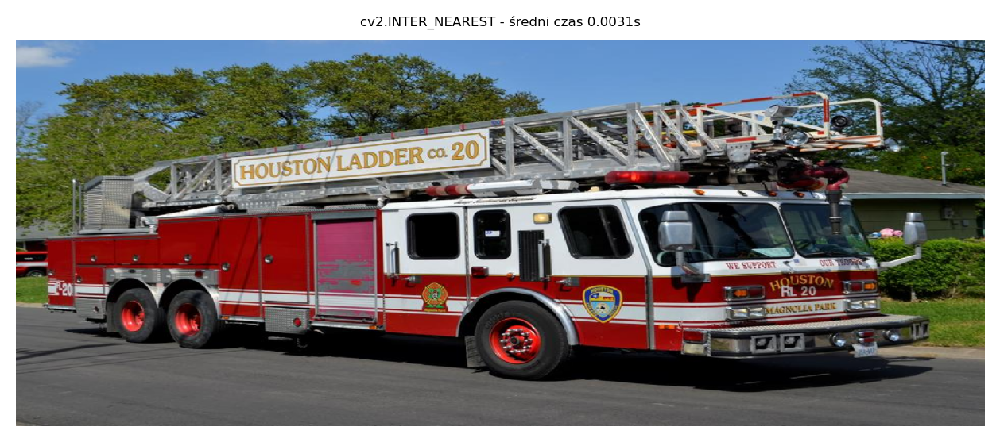

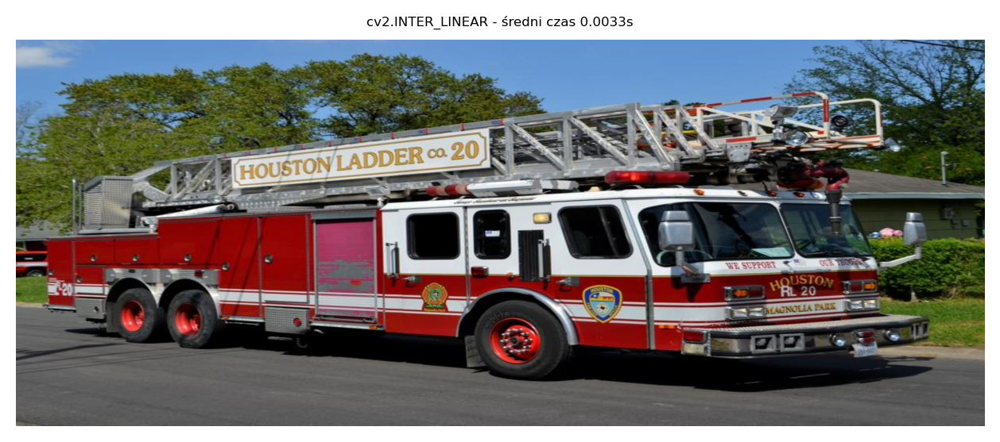

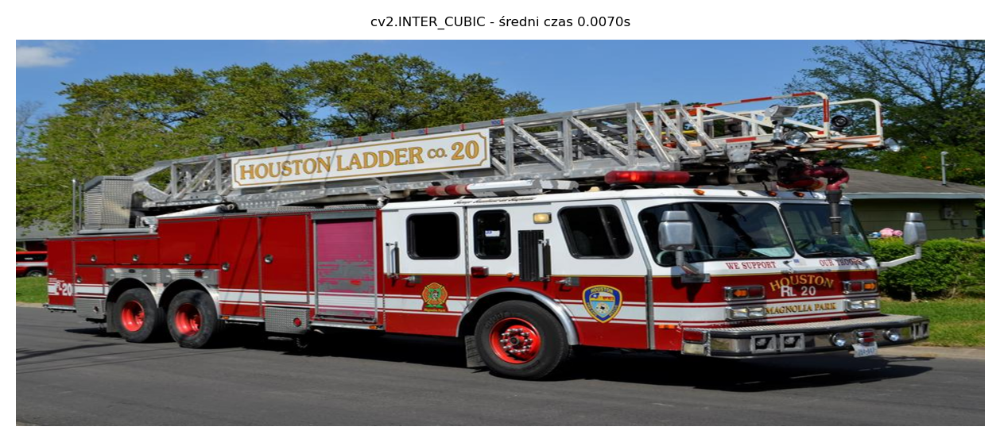

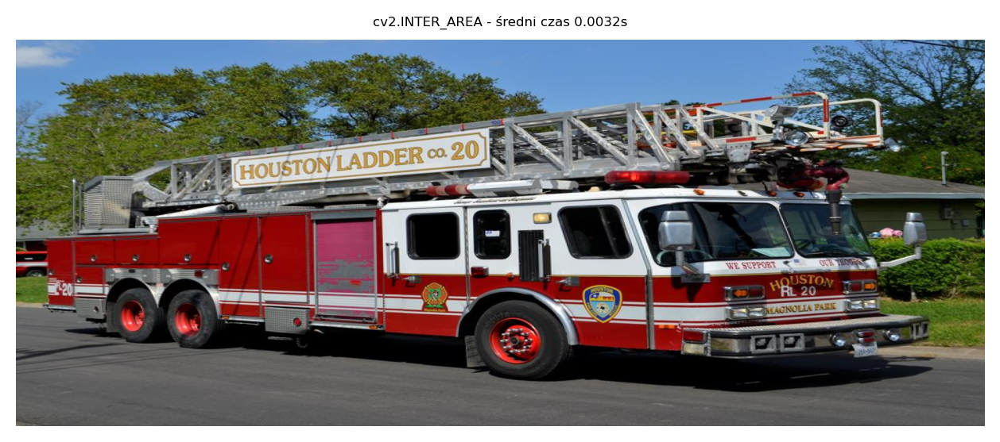

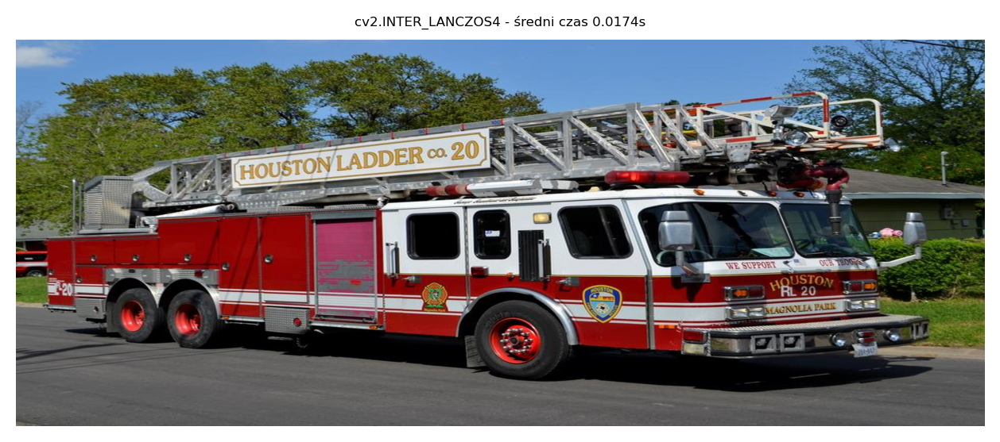


Porównanie metod interpolacji dla obrazu firetruck.jpg, współczynniki: 0.6, 0.8 -> rozmiar obrazka: 379.8x760.0


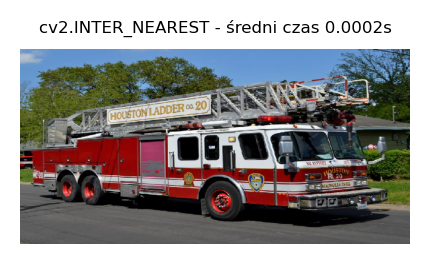

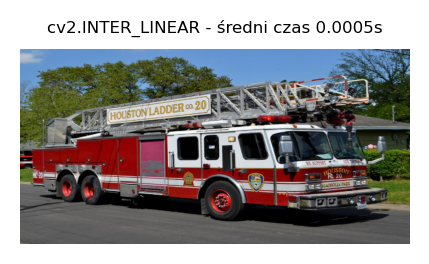

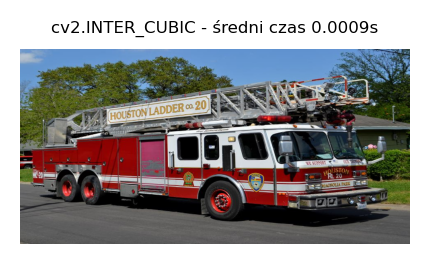

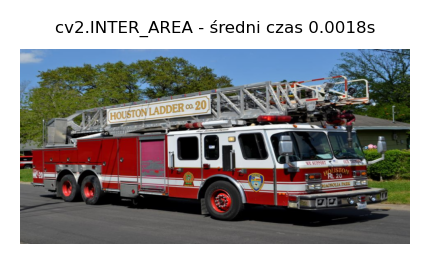

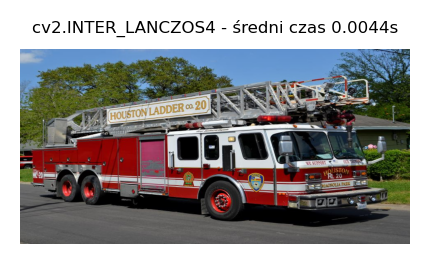

In [17]:
# Testy
compare_interpolation_methods(firetruck, "firetruck.jpg", 1.5, 1.5)
compare_interpolation_methods(firetruck, "firetruck.jpg", 2.5, 2.5)
compare_interpolation_methods(firetruck, "firetruck.jpg", 1.5, 2.5)
compare_interpolation_methods(firetruck, "firetruck.jpg", 0.6, 0.8)

## Rozdzielczość (dpi)

Omówioną wcześniej rozdzielczość przestrzenną (rozmiar) należy utożsamiać z rozmiarem macierzy, w której zapisany jest obraz.
W tym ujęciu rozmiar pojedynczego piksela nie ma specjalnego znaczenia.
Problem pojawia się, kiedy obraz trzeba wyświetlić lub wydrukować.
Wtedy pojedynczy piksel staje się "obiektem fizycznym" i musi mieć swój rozmiar (wysokość/szerokość/powierzchnię).

Parametr dpi (ang. *dots per inch*) określa liczbę kropek (pikseli), która mieści się na jednym calu (25,4 mm) długości/szerokości.
Dopiero kombinacja rozmiaru i rozdzielczości określa nam rzeczywisty rozmiar obrazu, jaki uzyskamy na wydruku.

Dpi staje się istotne w przypadku drukowania, gdyż wyświetlanie na monitorze odbywa się zazwyczaj 1 piksel obrazka = 1 piksel na monitorze (w przypadku maksymalnej rozdzielczości wspieranej przez monitor), ew. następuje automatyczne skalowanie.

Wpływ rozdzielczości można zademonstrować w następujący sposób:
- wczytaj obraz *lena.bmp*.  Ma on rozmiar $512 \times 512$.
- wykorzystując funkcję `imresize`, stwórz obrazy o rozmiarach $256 \times 256$, $128 \times 128$, $64 \times 64$ - metoda interpolacji jest w tym wypadku mniej istotna.
- wyświetl obrazy, wymuszając zachowanie na ekranie wejściowej rozdzielczości $512 \times 512$. W przypadku biblioteki *matplotlib* ta funkcjonalność jest domyślna.

Proszę zaobserwować, co dzieje się z obrazkiem.

In [18]:
lena_512 = cv2.imread('lena.bmp')
lena_512 = cv2.cvtColor(lena_512, cv2.COLOR_BGR2GRAY)

lena_256 = cv2.resize(lena_512, (256, 256))
lena_128 = cv2.resize(lena_512, (128, 128))
lena_64 = cv2.resize(lena_512, (64, 64))

In [19]:
# Pomocnicza funkcja do wyświetlenia wybranego obrazu 'lena'
def display_lena(lena_img):
    plt.title(f"Rozmiar obrazka: {lena_img.shape[0]}x{lena_img.shape[1]}", fontsize = 12)
    plt.imshow(lena_img, cmap = "gray")
    plt.axis('off')
    plt.show()

Porównanie obrazów lena.bmp o różnych rozmiarach dla tej samej rozdzielczości 512x512


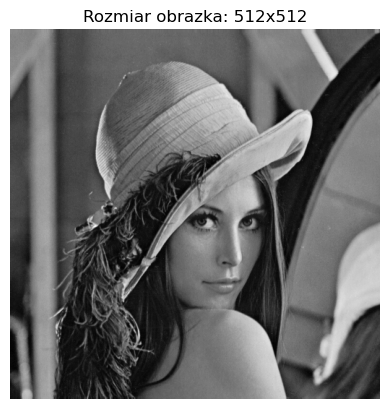

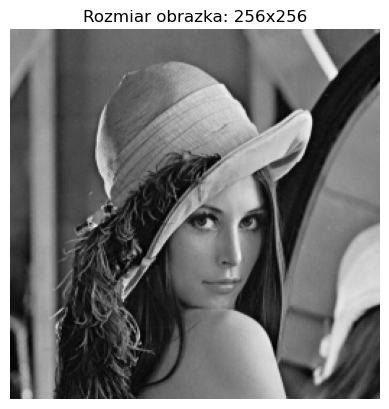

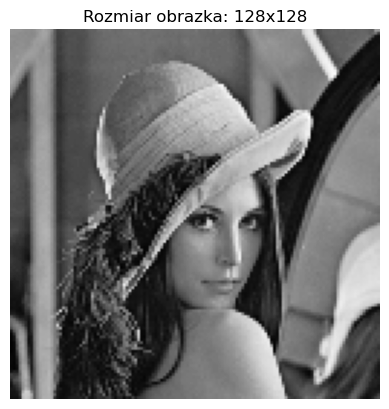

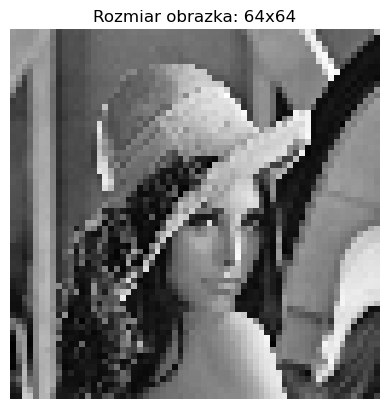

In [20]:
# TODO Porównanie
print("Porównanie obrazów lena.bmp o różnych rozmiarach dla tej samej rozdzielczości 512x512")

display_lena(lena_512)
display_lena(lena_256)
display_lena(lena_128)
display_lena(lena_64)

## Liczba poziomów jasności

Dla obrazów w skali szarości pojedynczy piksel zwykle zapisuje się na 8 bitach, co daje 256 rozróżnialnych poziomów szarości.
Dla większości zastosowań wartość ta jest wystarczająca (choć są kamery o wyjściu 12 lub 16 bitów).
Jednak oko ludzkie nie potrafi rozróżnić wszystkich 256 poziomów jasności (jest za mało czułe).
Zazwyczaj człowiek rozróżnia 20-30 poziomów szarości (to, ile i jakie dokładnie rozróżnia, zależy od konkretnego oświetlenia sceny i cech osobniczych).

W poniższych krokach zademonstrujemy omówione zjawisko:
- wczytaj (użyj) obrazu _lena_,
- wykorzystując znaną funkcję `normalize`, zmień liczbę poziomów szarości z 0-255 na:
    * 0-31,
    * 0-15,
    * 0-7,
    * 0-3,
    * 0-1 (binaryzacja).
- rezultaty wyświetl na wspólnym rysunku.

Podpowiedzi:
- trzeba przygotować tablice na obrazki, np. `I_31 = np.zeros(I.shape,'uint8')`,
- prawidłowe użycie funkcji normalize: `cv2.normalize(I, I_31, 0, 31, cv2.NORM_MINMAX)`,
- przykładowe wyświetlanie: `axsHist[0, 1].imshow(I, 'gray', vmin = 0, vmax = 31)`.

Czy rezultaty eksperymentu pasują do teorii o rozpoznawaniu przez człowieka ograniczonego zakresu poziomów jasności?
Wizualne porównanie których obrazów o tym świadczy?

In [21]:
# Pomocnicza funkcja do normalizowania obrazka
def normalize_image(image, lowest, highest):
    image_norm = np.zeros(image.shape, 'uint8')
    cv2.normalize(image, image_norm, lowest, highest, cv2.NORM_MINMAX)
    return image_norm

In [22]:
# Pomocnicza funkcja do wyświetlenia obrazów wspólnie
def display_normalized_images(image, image_name):
    I_31 = normalize_image(image, 0, 31)
    I_15 = normalize_image(image, 0, 15)
    I_7 = normalize_image(image, 0, 7)
    I_3 = normalize_image(image, 0, 3)
    I_1 = normalize_image(image, 0, 1)
    
    fig, axs = plt.subplots(2, 3)
    fig.set_size_inches(18, 10)
    fig.suptitle(f"Różna liczba poziomów szarości dla obrazu {image_name}", fontsize = 15)
    
    axs[0, 0].imshow(image, 'gray', vmin = 0, vmax = 255)
    axs[0, 0].set_title("256 poziomów szarości")
    axs[0, 0].axis('off')
    
    axs[0, 1].imshow(I_31, 'gray', vmin = 0, vmax = 31)
    axs[0, 1].set_title("32 poziomy szarości")
    axs[0, 1].axis('off')
    
    axs[0, 2].imshow(I_15, 'gray', vmin = 0, vmax = 15)
    axs[0, 2].set_title("16 poziomów szarości")
    axs[0, 2].axis('off')
    
    axs[1, 0].imshow(I_7, 'gray', vmin = 0, vmax = 7)
    axs[1, 0].set_title("8 poziomów szarości")
    axs[1, 0].axis('off')
    
    axs[1, 1].imshow(I_3, 'gray', vmin = 0, vmax = 3)
    axs[1, 1].set_title("4 poziomy szarości")
    axs[1, 1].axis('off')
    
    axs[1, 2].imshow(I_1, 'gray', vmin = 0, vmax = 1)
    axs[1, 2].set_title("2 poziomy szarości")
    axs[1, 2].axis('off')

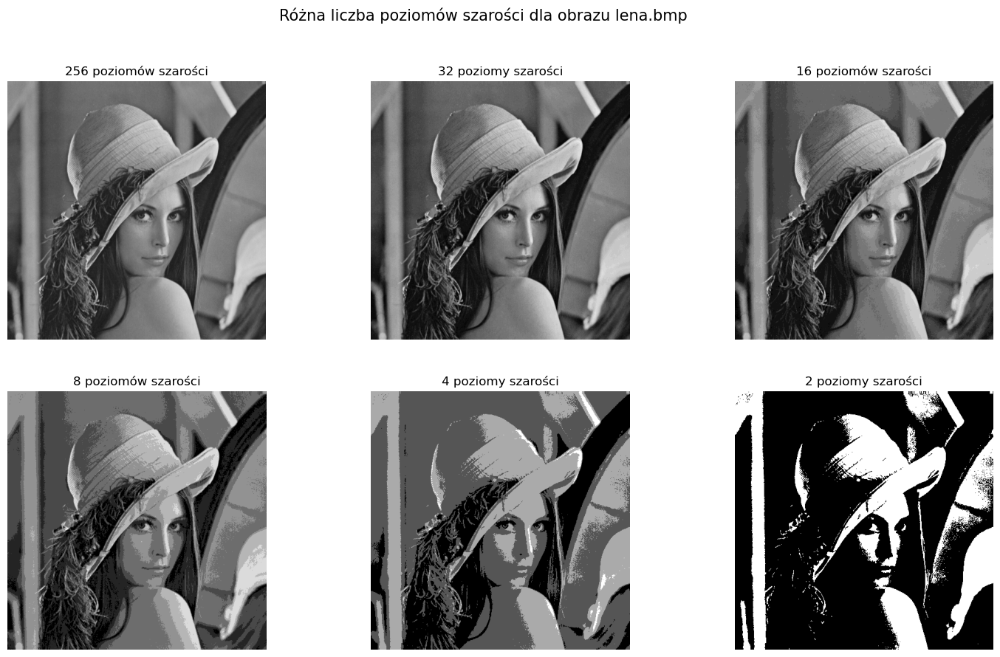

In [23]:
lena = cv2.imread('lena.bmp')
lena = cv2.cvtColor(lena, cv2.COLOR_BGR2GRAY)

#TODO Do samodzielnej realizacji
display_normalized_images(lena, "lena.bmp")


---

#### Czy rezultaty eksperymentu pasują do teorii o rozpoznawaniu przez człowieka ograniczonego zakresu poziomów jasności? Wizualne porównanie których obrazów o tym świadczy?

Wydaje mi się, że rezultaty tego eksperymentu pasują do tej teorii. Świadczy o tym szczególnie porównanie obrazu oryginalnego, z tym który ma 16 poziomów szarości, bowiem ciężko jest zauważyć na pierwszy rzut jakąkolwiek różnicę, dopiero widać ją dla 8 poziomów szarości - ale jakość obrazu wciąż jest całkiem wysoka. 

---
